In [1]:
import os
os.getcwd()

'/home/alifahsanul/Documents/research/tb_classification/data_prep'

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import pickle
import random
from tqdm import trange
random.seed(0)

In [3]:
def display_image(image, title=''):
    plt.imshow(image), plt.title(title)
    plt.show()
    return None

In [4]:
image_data_path = r'/home/alifahsanul/Documents/research/tb_classification/dataset/ChinaSet_AllFiles/CXR_png'
image_metadata_path = r'/home/alifahsanul/Documents/research/tb_classification/dataset/ChinaSet_AllFiles/ClinicalReadings'

In [5]:
is_image_list_saved = False
if is_image_list_saved:
    with open('processed_data.pkl', 'rb') as f:
        image_info_list = pickle.load(f)
else:
    image_info_list = []
    listdir = os.listdir(image_data_path)
    for i in trange(len(listdir)):
        f = listdir[i]
        if not(f.endswith('.png')):
            continue
        if i > 50: break
        data_dict = {}
        filename = f[:-4]
        metadata_filename = f'{filename}.txt'
        image_path = os.path.join(image_data_path, f)
        metadata_path = os.path.join(image_metadata_path, metadata_filename)
        image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
        dim = (800, 800) #h, w
        image = cv2.resize(image, dim, interpolation=cv2.INTER_LINEAR)
        with open(metadata_path) as f:
            lines = f.readlines()
            f.close()
        lines = [x.strip() for x in lines]
        lines = [x for x in lines if len(x)>0]
        detail = lines[0]
        sickness = lines[1]        
        data_dict['file'] = filename
        data_dict['image'] = image
        data_dict['detail'] = detail
        data_dict['sickness'] = sickness
        data_dict['image_path'] = image_path
        data_dict['metadata_path'] = metadata_path
        image_info_list.append(data_dict)
    with open('processed_data.pkl', 'wb') as f:
        pickle.dump(image_info_list, f)

  8%|▊         | 51/663 [00:07<01:32,  6.64it/s]


In [6]:
random.shuffle(image_info_list)
image_info_list = image_info_list[::]
len(image_info_list)

51

In [7]:
normal_image_info_list = [x for x in image_info_list if x['sickness']=='normal']
abnormal_image_info_list = [x for x in image_info_list if x['sickness']!='normal']
assert len(normal_image_info_list) >= 2
assert len(abnormal_image_info_list) >= 2
print(len(normal_image_info_list))
print(len(abnormal_image_info_list))

27
24


In [8]:
def plot_tile_img(my_list, filename):
    n_pic = len(my_list)
    n_cols = 2
    n_rows = round(n_pic / n_cols + 0.51)
    fig_h = n_rows * 25
    fig_w = n_cols * 22
    plt.rcParams['figure.figsize'] = (fig_w, fig_h)
    plt.subplots_adjust(wspace=0.01, hspace=0.01)
    for i, image_info in enumerate(my_list):
        image = image_info['image']
        title = image_info['detail'] + '\n' + image_info['sickness']
        plt.subplot(n_rows, n_cols, i+1)
        plt.imshow(image)
        plt.title(title, fontsize=30)
        plt.axis('off')
    plt.savefig(filename)
    return None

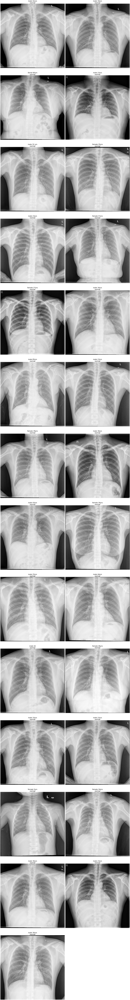

In [9]:
if len(normal_image_info_list) > 0:
    plot_tile_img(normal_image_info_list, 'normal.jpg')

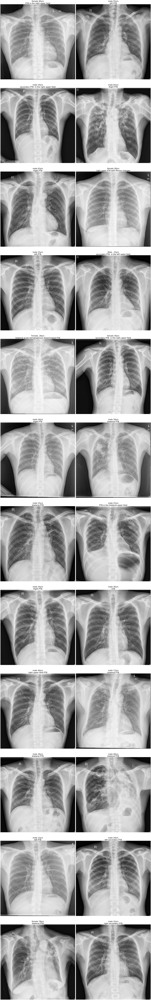

In [10]:
plot_tile_img(abnormal_image_info_list, 'abnormal.jpg')